In [6]:
import torch
import cv2
import matplotlib.pyplot as plt
import albumentations as albu
from torch.utils.data import Dataset, DataLoader
import os

In [7]:
class FractureDataset(Dataset):
    """Fracture dataset."""

    def __init__(self, image_folder, mask_folder, resize=None, transform=None, augmentation=None):
        """
        Args:
            csv_file (string): Path to the csv file with annotations.
            root_dir (string): Directory with all the images.
            transform (callable, optional): Optional transform to be applied
                on a sample.
        """
        self.image_folder = image_folder
        self.mask_folder = mask_folder
        self.images = [f for f in os.listdir(image_folder) if os.path.isfile(f"{image_folder}{f}")]
        self.masks = [f for f in os.listdir(mask_folder) if os.path.isfile(f"{mask_folder}{f}")]
        self.resize = resize
        self.transform = transform
        self.augmentation = augmentation

    def __len__(self):
        return len(self.images)
    
    def __getitem__(self, idx):
        if torch.is_tensor(idx):
            idx = idx.tolist()
            

        idx = idx % len(self.images)

        img_name = self.images[idx]
        image = cv2.imread(os.path.join(self.image_folder, img_name))
#         image = image_transpose_exif(image)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        shape = image.shape
                
#         grid = self.grid_frame.loc[idx, 'region_shape_attributes']
        mask = cv2.imread(os.path.join(self.mask_folder, img_name), 0)
        # mask = np.stack(masks, axis=-1).astype('float')
        
        if self.resize is not None:
            image, mask = cv2.resize(image, (320, 480)), cv2.resize(mask, (320, 480))
            mask = mask.reshape((*mask.shape, 1))
            
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
            
        if self.transform:
            sample = self.transform(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
        
        return image, mask

In [7]:
dataset = FractureDataset("../train_images/", "../train_masks/")

In [8]:
def visualize(**images):
    """PLot images in one row."""
    n = len(images)
    plt.figure(figsize=(16, 9))
    for i, (name, image) in enumerate(images.items()):
        plt.subplot(1, n, i + 1)
        plt.xticks([])
        plt.yticks([])
        plt.title(' '.join(name.split('_')).title(), color='white')
        plt.imshow(image)
    plt.show()

In [9]:
for x in range(5):
    out = dataset[x]
    visualize(
        image = out[0],
        mask = out[1].squeeze()
    )

NameError: name 'dataset' is not defined

In [ ]:
def get_training_augmentation():
    train_transform = [

        albu.HorizontalFlip(p=0.5),

        albu.ShiftScaleRotate(scale_limit=0.2, rotate_limit=20, shift_limit=0.2, p=0.8, border_mode=0),

        albu.PadIfNeeded(min_height=320, min_width=320, always_apply=True, border_mode=0),
        albu.RandomCrop(height=320, width=320, always_apply=True),

        albu.IAAAdditiveGaussianNoise(p=0.1),
        albu.IAAPerspective(p=0.5),

        albu.OneOf(
            [
                albu.CLAHE(p=1),
                albu.RandomBrightness(p=1),
                albu.RandomGamma(p=1),
            ],
            p=0.9,
        ),

#         albu.OneOf(
#             [
#                 albu.IAASharpen(p=1),
#                 albu.Blur(blur_limit=3, p=1),
#                 albu.MotionBlur(blur_limit=3, p=1),
#             ],
#             p=0.9,
#         ),

#         albu.OneOf(
#             [
#                 albu.RandomContrast(p=1),
#                 albu.HueSaturationValue(p=1),
#             ],
#             p=0.9,
#         ),
    ]
    return albu.Compose(train_transform)


def get_validation_augmentation():
    """Add paddings to make image shape divisible by 32"""
    test_transform = [
        albu.PadIfNeeded(320, 320)
    ]
    return albu.Compose(test_transform)


def to_tensor(x, **kwargs):
    return x.transpose(2, 0, 1).astype('float32')


def get_preprocessing(preprocessing_fn):
    """Construct preprocessing transform
    
    Args:
        preprocessing_fn (callbale): data normalization function 
            (can be specific for each pretrained neural network)
    Return:
        transform: albumentations.Compose
    
    """
    
    _transform = [
        albu.Lambda(image=preprocessing_fn),
        albu.Lambda(image=to_tensor, mask=to_tensor),
    ]
    return albu.Compose(_transform)

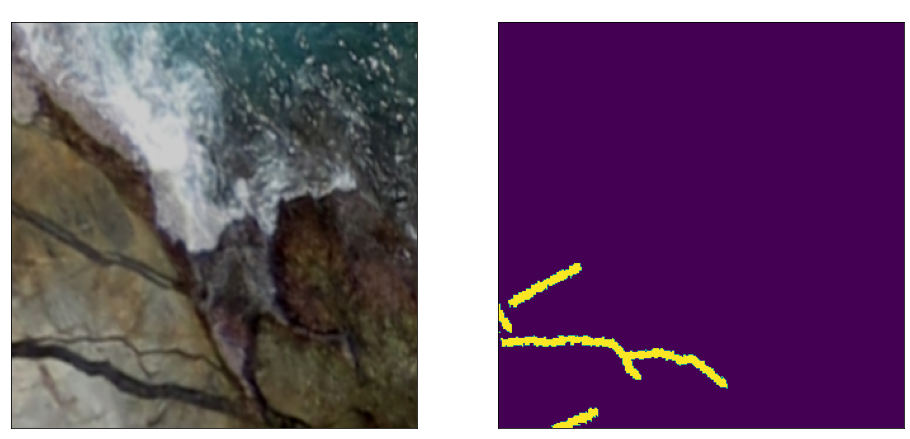

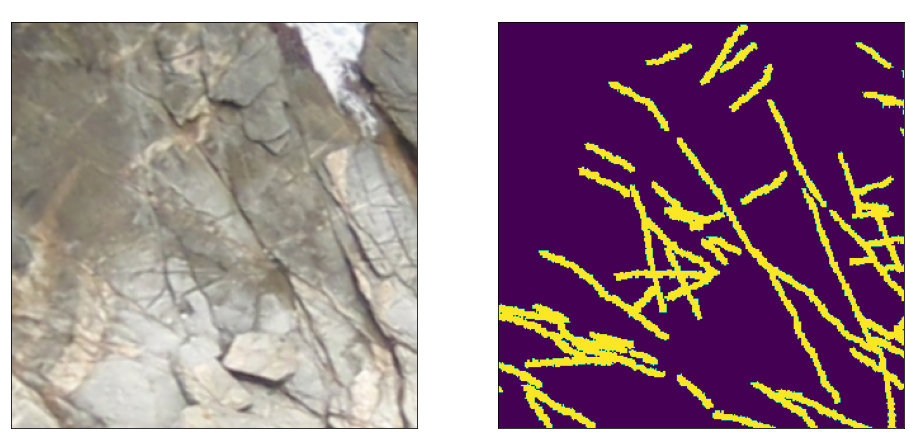

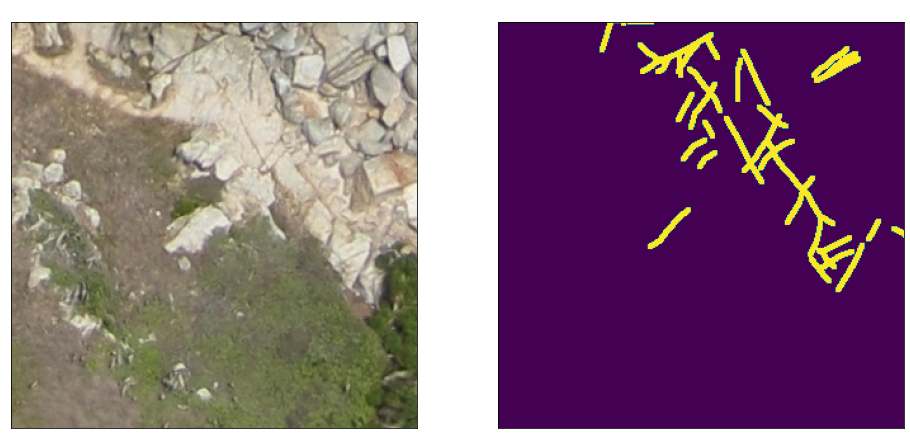

In [23]:
augmented_dataset = FractureDataset("../train_images/", "../train_masks/",
    augmentation=get_training_augmentation(), 
)

# same image with different random transforms
for i in range(3):
    image, mask = augmented_dataset[i]
    visualize(image=image, mask=mask.squeeze())

In [13]:
ENCODER = 'efficientnet-b3'
ENCODER_WEIGHTS = 'imagenet'
CLASSES = ['fracture']
ACTIVATION = 'sigmoid' # could be None for logits or 'softmax2d' for multiclass segmentation
DEVICE = torch.device('cuda:0')

In [10]:
import segmentation_models_pytorch as smp
# create segmentation model with pretrained encoder
model = smp.Unet(
    encoder_name=ENCODER, 
    encoder_weights=ENCODER_WEIGHTS, 
    classes=len(CLASSES), 
    activation=ACTIVATION,
).to('cuda')

NameError: name 'ENCODER' is not defined

In [17]:
preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

In [18]:
train_dataset = FractureDataset("../train_images/", "../train_masks/", True, 
                                     get_preprocessing(preprocessing_fn), 
                                     get_training_augmentation())
print('Number of training samples:', len(train_dataset))
valid_dataset = FractureDataset("../test_images/", "../test_masks/", True, 
                                     get_preprocessing(preprocessing_fn), 
                                     get_validation_augmentation())

Number of training samples: 193


In [39]:
train_loader = DataLoader(train_dataset, batch_size=1, shuffle=True, num_workers=0)
valid_loader = DataLoader(valid_dataset, batch_size=1, shuffle=False, num_workers=0)

In [40]:
# IoU/Jaccard score - https://en.wikipedia.org/wiki/Jaccard_index

# loss = smp.utils.losses.CrossEntropyLoss()
loss = smp.utils.losses.DiceLoss()
metrics = [
    smp.utils.metrics.IoU(threshold=0.5),
]

optimizer = torch.optim.Adam([ 
    dict(params=model.parameters(), lr=0.0005),
])

In [41]:
train_epoch = smp.utils.train.TrainEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    optimizer=optimizer,
    device=DEVICE,
    verbose=True,
)

valid_epoch = smp.utils.train.ValidEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    device=DEVICE,
    verbose=True,
)

In [53]:
max_score = 0

for i in range(0, 40):
    print('\nEpoch: {}'.format(i))
    
    train_logs = train_epoch.run(train_loader)
    valid_logs = valid_epoch.run(valid_loader)

    if max_score < valid_logs['iou_score']:
        max_score = valid_logs['iou_score']
        torch.save(model, './best_model_3.pth')
        print('Model saved!')

    if i == 15:
        new_lr = 5e-5
        optimizer.param_groups[0]['lr'] = new_lr
        print(f'Decrease decoder learning rate to {new_lr}!')


Epoch: 0
valid: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:04<00:00, 19.46it/s, dice_loss - 0.5838, iou_score - 0.2794]
Model saved!

Epoch: 1
valid: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:04<00:00, 19.59it/s, dice_loss - 0.5935, iou_score - 0.2732]

Epoch: 2
valid: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:04<00:00, 19.59it/s, dice_loss - 0.5927, iou_score - 0.2713]

Epoch: 3
valid: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:04<00:00, 19.57it/s, di

valid: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:04<00:00, 19.07it/s, dice_loss - 0.6078, iou_score - 0.2617]

Epoch: 17
valid: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:04<00:00, 19.17it/s, dice_loss - 0.5938, iou_score - 0.2713]

Epoch: 18
valid: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:04<00:00, 17.98it/s, dice_loss - 0.5945, iou_score - 0.2721]

Epoch: 19
valid: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:04<00:00, 18.39it/s, dice_loss - 0.5909, iou

KeyboardInterrupt: 

In [11]:
model = torch.load('./best_model_3.pth').to('cuda')

In [12]:
# test dataset without transformations for image visualization
test_dataset_vis = FractureDataset(
    "../test_images/", "../test_masks/" # resize=True 
)

In [46]:
model_cpu = model.to('cpu')

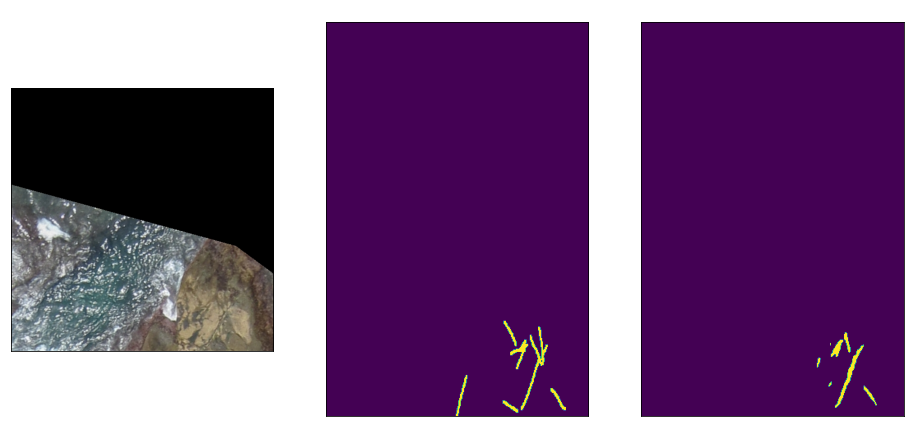

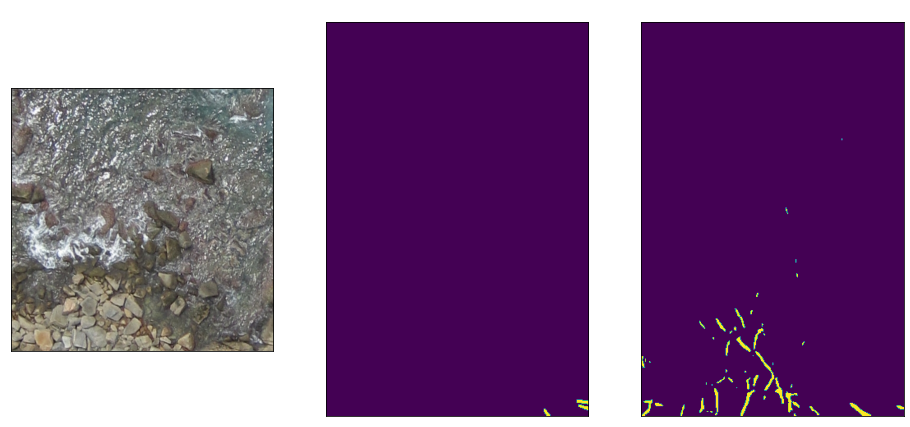

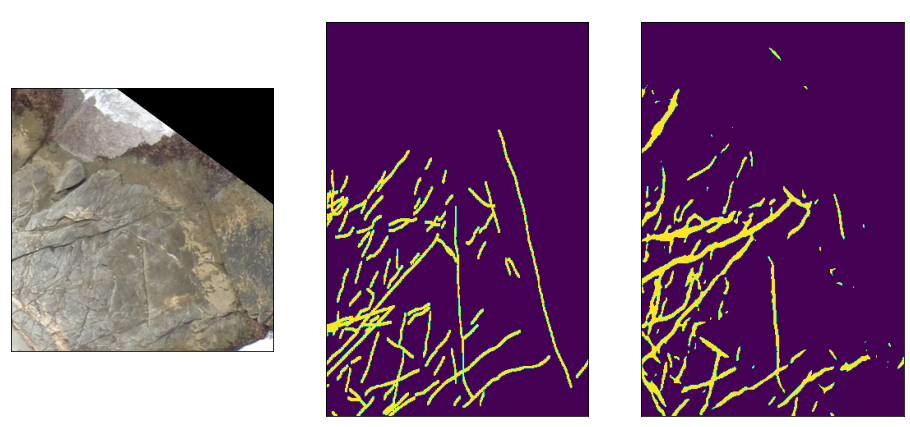

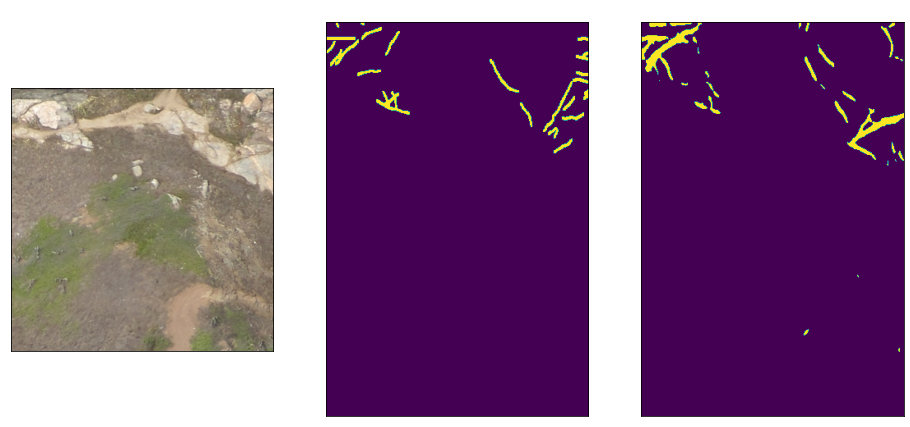

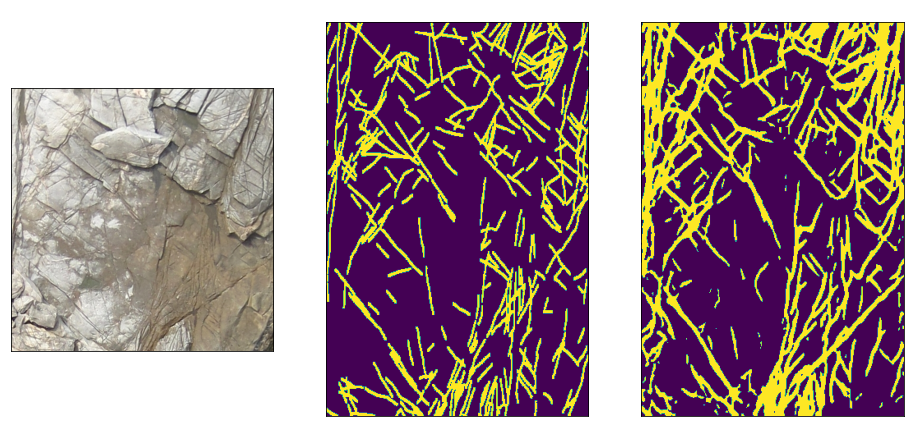

...

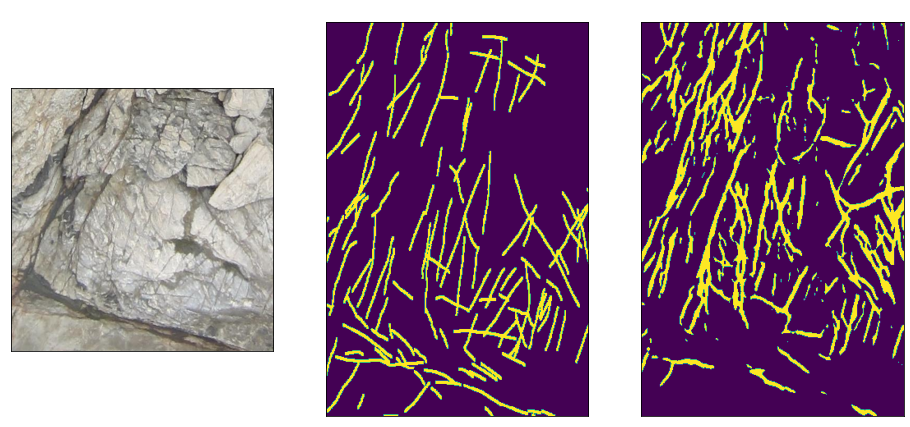

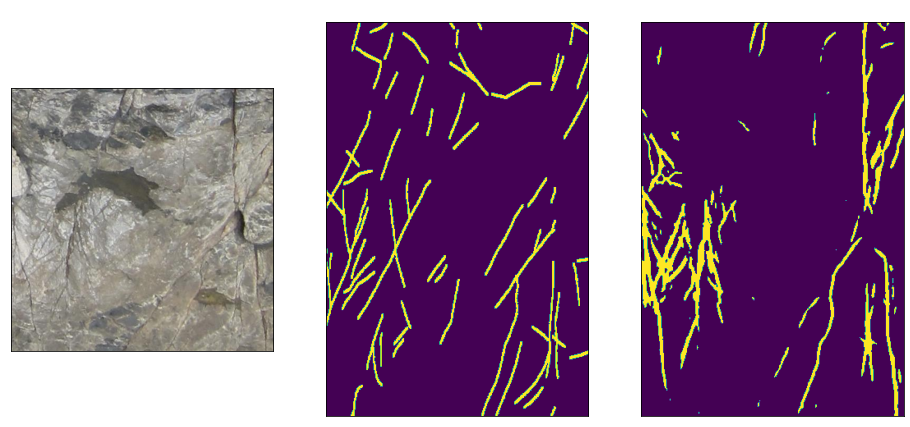

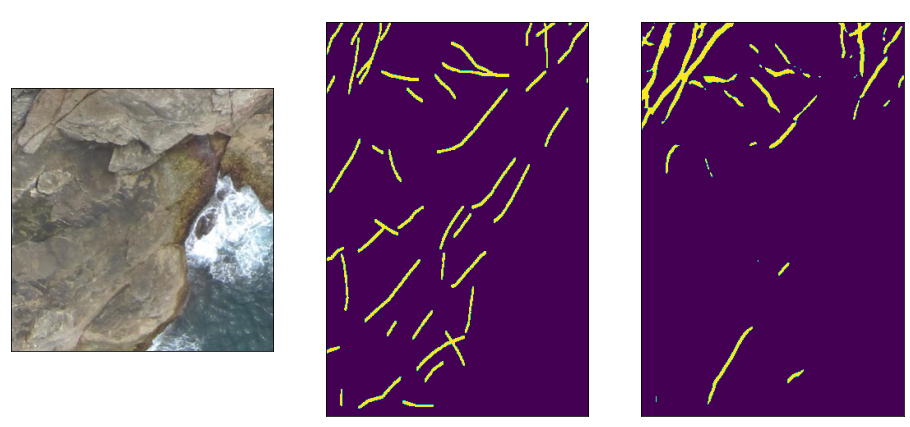

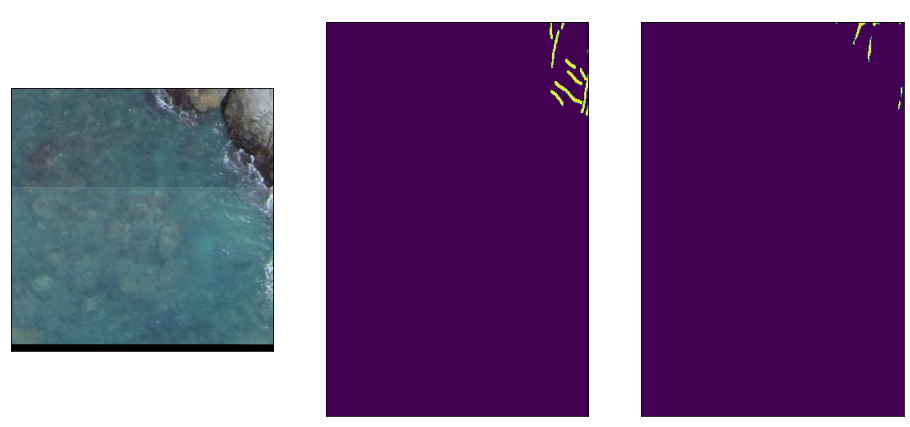

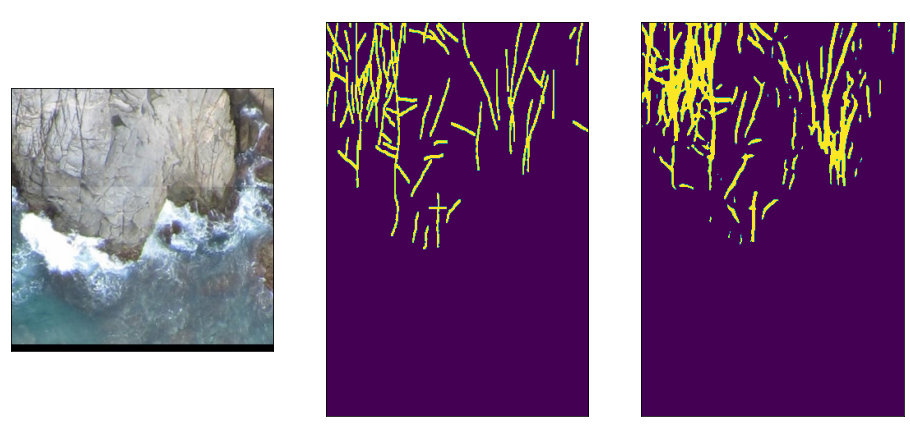

In [52]:
for i in range(len(test_dataset)):  
    torch.no_grad()
    image_vis = test_dataset_vis[i][0].astype('uint8')
    image, gt_mask = test_dataset[i]
    
    gt_mask = gt_mask.squeeze()
    
    x_tensor = torch.from_numpy(image).unsqueeze(0)
    pr_mask = model_cpu.predict(x_tensor)
    pr_mask = pr_mask.squeeze().numpy().round()
        
    
    visualize(
        image=image_vis, 
        actual=gt_mask, 
        predicted=pr_mask
    )

In [51]:
test_dataset = FractureDataset(
    "../test_images/", "../test_masks/", resize=True,
    augmentation=get_validation_augmentation(), 
    transform=get_preprocessing(preprocessing_fn),
)

test_dataloader = DataLoader(test_dataset)

### DENSENET

In [50]:
ENCODER = 'densenet161'
ENCODER_WEIGHTS = 'imagenet'
CLASSES = ['fracture']
ACTIVATION = 'sigmoid' # could be None for logits or 'softmax2d' for multiclass segmentation
DEVICE = torch.device('cuda:0')

In [51]:
import segmentation_models_pytorch as smp
# create segmentation model with pretrained encoder
model = smp.Unet(
    encoder_name=ENCODER, 
    encoder_weights=ENCODER_WEIGHTS, 
    classes=len(CLASSES), 
    activation=ACTIVATION,
).to('cuda')

In [52]:
preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)


In [53]:
train_dataset = FractureDataset("../train_images/", "../train_masks/", True, 
                                     get_preprocessing(preprocessing_fn), 
                                     get_training_augmentation())
print('Number of training samples:', len(train_dataset))
valid_dataset = FractureDataset("../test_images/", "../test_masks/", True, 
                                     get_preprocessing(preprocessing_fn), 
                                     get_validation_augmentation())

Number of training samples: 193


In [54]:
train_loader = DataLoader(train_dataset, batch_size=1, shuffle=True, num_workers=0)
valid_loader = DataLoader(valid_dataset, batch_size=1, shuffle=False, num_workers=0)

In [55]:
# IoU/Jaccard score - https://en.wikipedia.org/wiki/Jaccard_index

# loss = smp.utils.losses.CrossEntropyLoss()
loss = smp.utils.losses.DiceLoss()
metrics = [
    smp.utils.metrics.IoU(threshold=0.5),
]

optimizer = torch.optim.Adam([ 
    dict(params=model.parameters(), lr=5e-5),
])

In [56]:
# model = torch.load('./best_model_densenet2.pth').to('cuda')

In [57]:
train_epoch = smp.utils.train.TrainEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    optimizer=optimizer,
    device=DEVICE,
    verbose=True,
)

valid_epoch = smp.utils.train.ValidEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    device=DEVICE,
    verbose=True,
)

In [58]:
max_score = 0

for i in range(0, 40):
    print('\nEpoch: {}'.format(i))
    
    train_logs = train_epoch.run(train_loader)
    valid_logs = valid_epoch.run(valid_loader)

    if max_score < valid_logs['iou_score']:
        max_score = valid_logs['iou_score']
        torch.save(model, './best_model_densenet2.pth')
        print('Model saved!')

    if i == 15:
        new_lr = 5e-5
        optimizer.param_groups[0]['lr'] = new_lr
        print(f'Decrease decoder learning rate to {new_lr}!')


Epoch: 0
valid: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:06<00:00, 12.28it/s, dice_loss - 0.8611, iou_score - 0.09363]
Model saved!

Epoch: 1
valid: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:06<00:00, 12.47it/s, dice_loss - 0.8351, iou_score - 0.1249]
Model saved!

Epoch: 2
valid: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:06<00:00, 12.44it/s, dice_loss - 0.8053, iou_score - 0.1445]
Model saved!

Epoch: 3
valid: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [0

valid: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:06<00:00, 12.24it/s, dice_loss - 0.6571, iou_score - 0.2315]

Epoch: 17
valid: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:06<00:00, 12.23it/s, dice_loss - 0.6178, iou_score - 0.2618]
Model saved!

Epoch: 18
valid: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:06<00:00, 12.15it/s, dice_loss - 0.6469, iou_score - 0.2329]

Epoch: 19
valid: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:06<00:00, 12.20it/s, dice_loss 

valid: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:06<00:00, 12.19it/s, dice_loss - 0.5938, iou_score - 0.273]

Epoch: 33
valid: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:06<00:00, 11.78it/s, dice_loss - 0.5971, iou_score - 0.2712]

Epoch: 34
valid: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:06<00:00, 12.30it/s, dice_loss - 0.652, iou_score - 0.2222]

Epoch: 35
valid: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 82/82 [00:06<00:00, 12.11it/s, dice_loss - 0.5935, iou

In [59]:
# model = torch.load('./best_model_3.pth').to('cuda')
model_cpu = model.to('cpu')

In [60]:
test_dataset_vis = FractureDataset(
    "../test_images/", "../test_masks/" # resize=True 
)

In [61]:
test_dataset = FractureDataset(
    "../test_images/", "../test_masks/", resize=True,
    augmentation=get_validation_augmentation(), 
    transform=get_preprocessing(preprocessing_fn),
)

test_dataloader = DataLoader(test_dataset)

In [67]:
for i in range(len(test_dataset)):  
    
    torch.no_grad()
    image_vis = test_dataset_vis[i][0].astype('uint8')
    image, gt_mask = test_dataset[i]
    
    gt_mask = gt_mask.squeeze()
    
    x_tensor = torch.from_numpy(image).unsqueeze(0)
    pr_mask = model_cpu.predict(x_tensor)
    pr_mask = pr_mask.squeeze().numpy().round()
        
    pr_mask_full = cv2.resize(pr_mask, (500,500))
    cv2.imwrite(f"../new_model_masks/{test_dataset.images[i]}", pr_mask_full)